In [ ]:
import cv2
import numpy as np
import matplotlib.pylab as plt
from google.colab.patches import cv2_imshow
  
def imshow(tit, image) :
    plt.title(tit)    
    if len(image.shape) == 3 :
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    else :
        plt.imshow(image, cmap="gray")  

# 명함인식

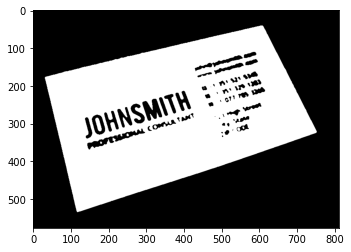

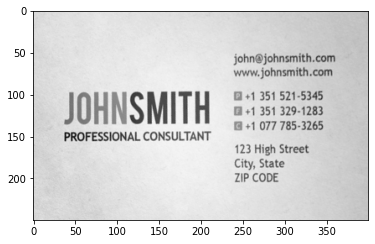

In [ ]:
img = cv2.imread('namecard.PNG', 0)

gray = cv2.GaussianBlur(img, (13, 13), 0)
_,binary = cv2.threshold(gray, 170, 255, cv2.THRESH_BINARY)

imshow("", binary); plt.show()

closed = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, None,iterations=2)

imshow("", closed )

contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)

card = contours[0]
peri = cv2.arcLength(card, True)
approx = cv2.approxPolyDP(card, 0.02*peri,True).astype(np.float32) 

h = np.array([ [399,0],[0,0],[0,250],[399,250] ],np.float32)
approx = approx.reshape(4,2)
transform = cv2.getPerspectiveTransform(approx, h)  # 대응관계 계산

output = cv2.warpPerspective(img,transform, (400,250))   # 영상을 변환
imshow("", output)

In [ ]:
!sudo apt install tesseract-ocr
!pip install pytesseract

In [ ]:
import pytesseract

text = pytesseract.image_to_string(output)
print(text)

JOHNSMITH

PROFESSIONAL CONSULTANT

john@johnsmith.com
www. johnsmith.com

+1 351 521-5345
+1 351 329-1283
+1 077 785-3265

123 High Street
City, State
ZIP CODE



# Haar-like 기반 얼굴 검출 

In [ ]:
classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

In [ ]:
%%time
faces = classifier.detectMultiScale(src, minNeighbors=1)

CPU times: user 230 ms, sys: 0 ns, total: 230 ms
Wall time: 126 ms


In [ ]:
src = cv2.imread('mask.PNG')

faces = classifier.detectMultiScale(src, minNeighbors=1)
print(faces)

[[  0 109 215 215]]


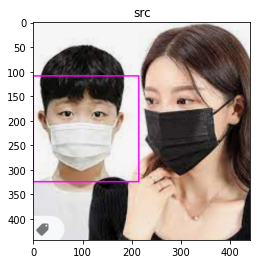

In [ ]:
for (x, y, w, h) in faces:
        cv2.rectangle(src, (x, y), (x + w, y + h), (255, 0, 255), 2)

imshow('src', src)

# 눈 검출

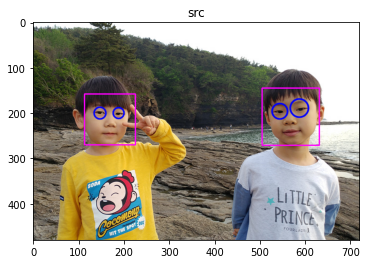

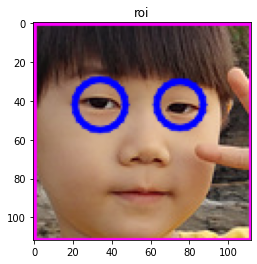

In [ ]:
face_classifier = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
eye_classifier = cv2.CascadeClassifier('haarcascade_eye.xml')

src = cv2.imread('kids.png')

faces = face_classifier.detectMultiScale(src)

for (x1, y1, w1, h1) in faces:
        cv2.rectangle(src, (x1, y1), (x1 + w1, y1 + h1), (255, 0, 255), 2)

        faceROI = src[y1:y1 + h1, x1:x1 + w1]
        eyes = eye_classifier.detectMultiScale(faceROI)

        for (x2, y2, w2, h2) in eyes:
            center = (int(x2 + w2 / 2), int(y2 + h2 / 2))
            cv2.circle(faceROI, center, int(w2 / 2), (255, 0, 0), 2, cv2.LINE_AA)

imshow('src', src); plt.show()
imshow("roi", faceROI)

# 보행자 검출

In [ ]:
hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())


[[620 288  72 144]
 [158 400  75 150]
 [328 123  66 131]]


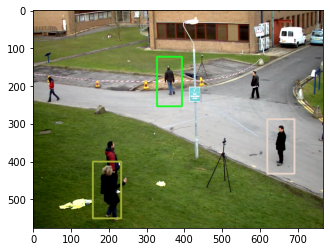

In [ ]:
import random 
frame = cv2.imread('vtest.png')

detected, _ = hog.detectMultiScale(frame)

print(detected)

for (x, y, w, h) in detected:
        c = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.rectangle(frame, (x, y), (x + w, y + h), c, 3)

imshow("", frame)

In [ ]:
cap = cv2.VideoCapture('vtest.avi')

if not cap.isOpened():
    print('Video open failed!')
    sys.exit()

hog = cv2.HOGDescriptor()
hog.setSVMDetector(cv2.HOGDescriptor_getDefaultPeopleDetector())

while True:
    ret, frame = cap.read()

    if not ret:
        break

    detected, _ = hog.detectMultiScale(frame)

    for (x, y, w, h) in detected:
        c = (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
        cv2.rectangle(frame, (x, y), (x + w, y + h), c, 3)

    cv2.imshow('frame', frame)
    if cv2.waitKey(10) == 27:
        break
cv2.destroyAllWindows()

# QR code reader

In [ ]:
detector = cv2.QRCodeDetector()

frame = cv2.imread('frame.png')

info, points, _ = detector.detectAndDecode(frame)

print(info)
print(points)

In [ ]:
!pip install zbar-py

In [ ]:
import zbar

frame = cv2.imread('frame.png', 0 )
scanner = zbar.Scanner()
result = scanner.scan(frame)
print(result)
print(result[0].data)

[Symbol(type='QR-Code', data=b'\xec\x95\x88\xeb\x85\x95\xed\x95\x98\xec\x84\xb8\xec\x9a\x94 http://www.google.co.kr', quality=1, position=[(33, 33), (33, 266), (267, 267), (266, 33)])]
b'\xec\x95\x88\xeb\x85\x95\xed\x95\x98\xec\x84\xb8\xec\x9a\x94 http://www.google.co.kr'


# DNN 모듈을 이용한 숫자 인식

In [ ]:
net = cv2.dnn.readNet('mnist_cnn.pb')


In [ ]:
img = cv2.imread('3.png', 0)
print(img.shape)
blob = cv2.dnn.blobFromImage(img, 1/255., (28, 28))
net.setInput(blob)

prob = net.forward()



(40, 40)


In [ ]:
print(img.shape)
print(blob.shape)   #  NCHW
print(prob.shape)   # 1 x 10
print(prob)

(40, 40)
(1, 1, 28, 28)
(1, 10)
[[6.4451665e-33 1.7990656e-23 3.9773240e-25 1.0000000e+00 2.5798696e-27
  2.6780479e-16 4.7647656e-28 1.4106819e-20 1.0647389e-25 1.4866106e-22]]


In [ ]:
print(np.max(prob))
print(np.argmax(prob, axis=1))

1.0
[3]


# 숫자 그리고 인식하기

In [ ]:
oldx, oldy = -1, -1

def on_mouse(event, x, y, flags, _):
    global oldx, oldy

    if event == cv2.EVENT_LBUTTONDOWN:
        oldx, oldy = x, y

    elif event == cv2.EVENT_LBUTTONUP:
        oldx, oldy = -1, -1

    elif event == cv2.EVENT_MOUSEMOVE:
        if flags & cv2.EVENT_FLAG_LBUTTON:
            cv2.line(img, (oldx, oldy), (x, y), (255, 255, 255), 40, cv2.LINE_AA)
            oldx, oldy = x, y
            cv2.imshow('img', img)


net = cv2.dnn.readNet('mnist_cnn.pb')

if net.empty():
    print('Network load failed!')
    sys.exit()

img = np.zeros((400, 400), np.uint8)

cv2.imshow('img', img)
cv2.setMouseCallback('img', on_mouse)

while True:
    c = cv2.waitKey()

    if c == 27:
        break
    elif c == ord(' '):
        blob = cv2.dnn.blobFromImage(img, 1/255., (28, 28))
        net.setInput(blob)
        prob = net.forward()
        print(prob)
        
        digit =  np.argmax(prob, axis=1)[0]

        print('%d ' % digit)

        img.fill(0)
        cv2.imshow('img', img)

cv2.destroyAllWindows()

# googlenet 이용한 영상 인식

- http://dl.caffe.berkeleyvision.org/bvlc_googlenet.caffemodel
- deploy_c.prototxt

In [ ]:
net = cv2.dnn.readNet('bvlc_googlenet.caffemodel', 'deploy_c.prototxt')

In [ ]:
filename = 'scooter.jpg'
img = cv2.imread(filename)

inputBlob = cv2.dnn.blobFromImage(img, 1, (224, 224), (104, 117, 123))  
net.setInput(inputBlob)
prob = net.forward()

In [ ]:
np.argmax(prob, axis=1), prob[0, 670]

(array([670]), 0.592074)

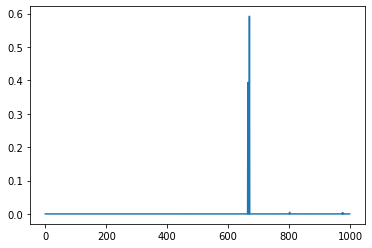

In [ ]:
import matplotlib.pyplot as plt

plt.plot(prob.flatten())

In [ ]:
prob.shape

(1, 1000)

In [ ]:
classNames = None
with open('classification_classes_ILSVRC2012.txt', 'rt') as f:
    classNames = f.read().rstrip('\n').split('\n')
classNames[670]  

'motor scooter, scooter'

In [ ]:
  classNames[np.argmax(prob, axis=1)[0]]

'motor scooter, scooter'

motor scooter, scooter (59.21%)


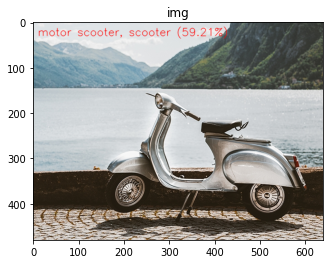

In [ ]:
confidence = np.max(prob)
classId = np.argmax(prob, axis=1)[0]
str = '%s (%4.2f%%)' % (classNames[classId], confidence * 100)
cv2.putText(img, str, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 1, cv2.LINE_AA)
print(str)
imshow('img', img)

crossword puzzle, crossword (98.55%)


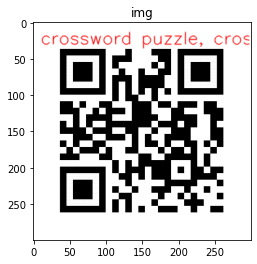

In [ ]:
filename = 'qrcode.png'
img = cv2.imread(filename)

inputBlob = cv2.dnn.blobFromImage(img, 1, (224, 224), (104, 117, 123))  
net.setInput(inputBlob)
prob = net.forward()

confidence = np.max(prob)
classId = np.argmax(prob, axis=1)[0]
str = '%s (%4.2f%%)' % (classNames[classId], confidence * 100)
cv2.putText(img, str, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 1, cv2.LINE_AA)
print(str)
imshow('img', img)

# 딥러닝 기반 얼굴 검출

 - https://raw.githubusercontent.com/opencv/opencv_3rdparty/dnn_samples_face_detector_20180205_fp16/res10_300x300_ssd_iter_140000_fp16.caffemodel 


In [ ]:
model = 'res10_300x300_ssd_iter_140000_fp16.caffemodel'
config = 'deploy.prototxt'

net = cv2.dnn.readNet(model, config)

In [ ]:
frame = cv2.imread('kids.png');

blob = cv2.dnn.blobFromImage(frame, 1, (300, 300), (104, 177, 123))
net.setInput(blob)
detect = net.forward()

In [ ]:
print(detect.shape)   

(1, 1, 200, 7)


In [ ]:
detect[0,0,2,:]

array([0.        , 1.        , 0.39431843, 0.1984471 , 0.7491548 ,
       0.27548686, 0.89186954], dtype=float32)

In [ ]:
detect[0,0,:,2]

In [ ]:
h, w, _ = frame.shape
detect[0,0,2,3] * w, detect[0,0,2,4] * h

(142.88190722465515, 359.5943069458008)

3


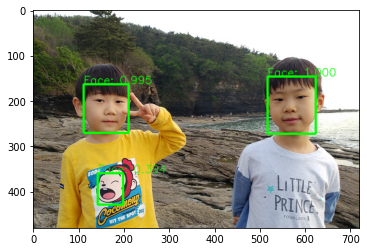

In [ ]:
cnt = 0
for i in range(detect.shape[2]):
    confidence = detect[0, 0, i, 2]
    if confidence < 0.3: continue
    cnt = cnt + 1
    x1 = int(detect[0,0, i, 3] * w)
    y1 = int(detect[0,0, i, 4] * h)
    x2 = int(detect[0,0, i, 5] * w)
    y2 = int(detect[0,0, i, 6] * h)

    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 4)

    label = 'Face: %4.3f' % confidence
    cv2.putText(frame, label, (x1, y1 - 1), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)
print(cnt)

imshow("", frame)

(1, 1, 200, 7)
2


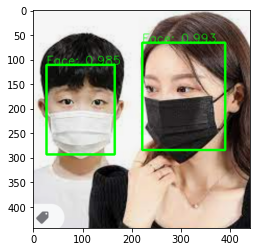

In [ ]:
frame = cv2.imread('mask.PNG');

blob = cv2.dnn.blobFromImage(frame, 1, (300, 300), (104, 177, 123))
net.setInput(blob)
detect = net.forward()
print(detect.shape)
h, w, _ = frame.shape

cnt = 0
for i in range(detect.shape[2]):
    confidence = detect[0, 0, i, 2]
    if confidence < 0.2: continue
    cnt = cnt + 1
    x1 = int(detect[0,0, i, 3] * w)   #  
    y1 = int(detect[0,0, i, 4] * h)
    x2 = int(detect[0,0, i, 5] * w)
    y2 = int(detect[0,0, i, 6] * h)

    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 4)

    label = 'Face: %4.3f' % confidence
    cv2.putText(frame, label, (x1, y1 - 1), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 1, cv2.LINE_AA)
print(cnt)

imshow("", frame)


In [ ]:
%%time
detect = net.forward()
detect

CPU times: user 175 ms, sys: 615 µs, total: 175 ms
Wall time: 108 ms


# mobile SSD 를 이용한 객체 검출

In [ ]:
classNames = { 0: 'background',
    1: 'aeroplane', 2: 'bicycle', 3: 'bird', 4: 'boat',
    5: 'bottle', 6: 'bus', 7: 'car', 8: 'cat', 9: 'chair',
    10: 'cow', 11: 'diningtable', 12: 'dog', 13: 'horse',
    14: 'motorbike', 15: 'person', 16: 'pottedplant',
    17: 'sheep', 18: 'sofa', 19: 'train', 20: 'tvmonitor' }

weight = 'MobileNetSSD_deploy.caffemodel'
config = 'MobileNetSSD_deploy.prototxt'

net = cv2.dnn.readNet(config, weight)

In [ ]:
frame = cv2.imread('ssd.jpg');

blob = cv2.dnn.blobFromImage(frame, 0.007843, (300, 300), (127.5, 127.5, 127.5), False)
net.setInput(blob)

In [ ]:
%%time
detect = net.forward()
print(detect.shape)

(1, 1, 100, 7)
CPU times: user 328 ms, sys: 0 ns, total: 328 ms
Wall time: 172 ms


In [ ]:
detect[0,0, 11,:]

array([ 0.        , 15.        ,  0.45273715,  0.5021077 ,  0.16018236,
        0.7477034 ,  0.8546665 ], dtype=float32)

bicycle: 0.999
bicycle: 0.980
car: 0.735
motorbike: 0.991
person: 0.980
person: 0.968
person: 0.932
person: 0.771
person: 0.739
person: 0.586
person: 0.499
person: 0.453
12


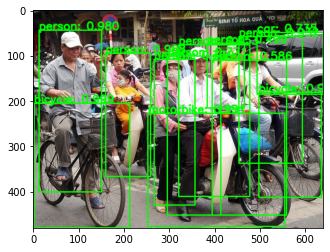

In [ ]:
frame = cv2.imread('ssd.jpg');

h, w, _ = frame.shape

cnt = 0
for i in range(detect.shape[2]):
    confidence = detect[0, 0, i, 2]
    if confidence < 0.1: continue

    cnt = cnt + 1
    x1 = int(detect[0,0, i, 3] * w)     
    y1 = int(detect[0,0, i, 4] * h)
    x2 = int(detect[0,0, i, 5] * w)
    y2 = int(detect[0,0, i, 6] * h)

    
    class_id = int(detect[0, 0, i, 1])       

    #if class_id == 7 :
    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
    name = classNames[class_id]
    label = '%s: %4.3f' % (name, confidence)
    cv2.putText(frame, label, (x1, y1 - 1), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2, cv2.LINE_AA)
    print(label)   

print(cnt)

imshow("", frame)


In [ ]:
detections[0,0, :,2]

array([0.9985384 , 0.9802485 , 0.7346354 , 0.9911423 , 0.97975624,
       0.9684324 , 0.9318966 , 0.7714161 , 0.7390635 , 0.58560294,
       0.49877304, 0.45273715, 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

car: 0.984
car: 0.971
car: 0.950
car: 0.915
car: 0.912
car: 0.874
car: 0.857
car: 0.849
car: 0.814
car: 0.764
car: 0.761
car: 0.656
car: 0.599
car: 0.504
car: 0.478
car: 0.468
car: 0.429
car: 0.308
car: 0.301
car: 0.301
motorbike: 0.272
person: 0.656
person: 0.399
23


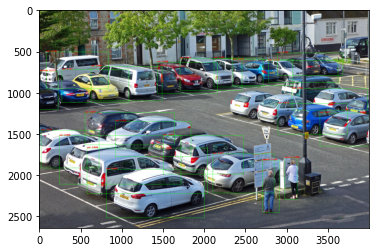

In [ ]:
frame = cv2.imread('car2.jpg');

blob = cv2.dnn.blobFromImage(frame, 0.007843, (300, 300), (127.5, 127.5, 127.5), False)
net.setInput(blob)
detect = net.forward()

h, w, _ = frame.shape

cnt = 0
for i in range(detect.shape[2]):
    confidence = detect[0, 0, i, 2]
    if confidence < 0.1: continue

    cnt = cnt + 1
    x1 = int(detect[0,0, i, 3] * w)     
    y1 = int(detect[0,0, i, 4] * h)
    x2 = int(detect[0,0, i, 5] * w)
    y2 = int(detect[0,0, i, 6] * h)
    class_id = int(detect[0, 0, i, 1])       

    cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
    name = classNames[class_id]
    label = '%s: %4.3f' % (name, confidence)
    cv2.putText(frame, label, (x1, y1 - 1), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2, cv2.LINE_AA)
    print(label)   

print(cnt)

imshow("", frame)


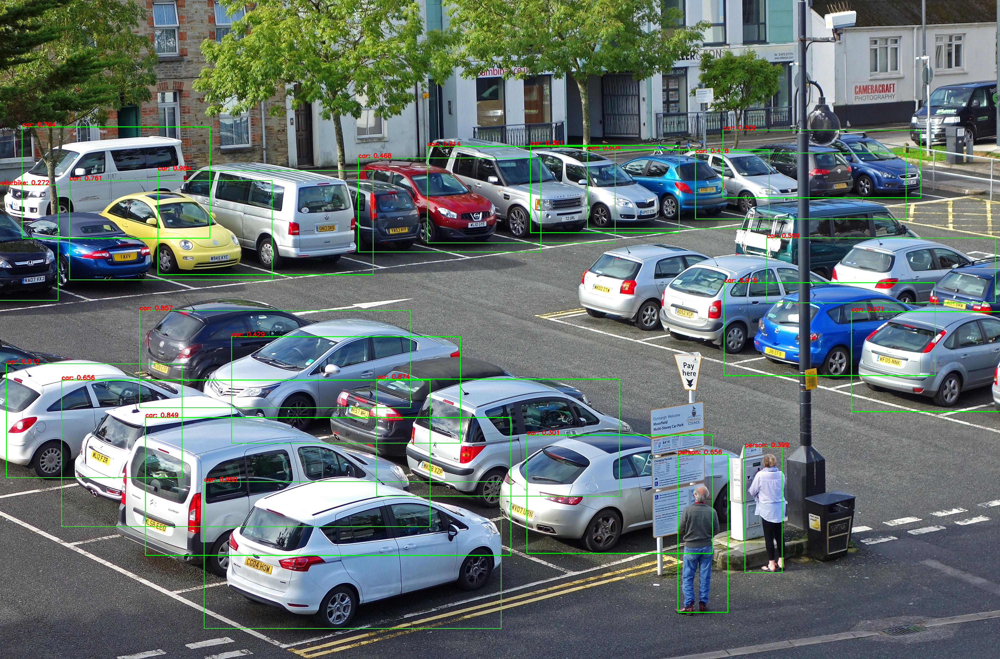

In [ ]:
cv2_imshow(frame)